# Exploring Concepts with Stanford Dogs Dataset

This notebook explores the Stanford Dogs dataset using CLIP embeddings and **3 different types of autoencoders**:

1. **MLP Autoencoder** - Standard feedforward autoencoder
2. **Variational Autoencoder (VAE)** - With KL divergence regularization
3. **Sparse Autoencoder** - With L1 sparsity penalty

We'll compare their reconstruction quality and latent space properties.


## 1. Setup and Download Dataset


In [1]:
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader, random_split
from pathlib import Path
import matplotlib.pyplot as plt
from PIL import Image
from tqdm import tqdm
import random

device = "cuda" if torch.cuda.is_available() else "cpu"
print(f"Device: {device}")

Device: cuda


In [2]:
import kagglehub

# Download Stanford Dogs dataset
path = kagglehub.dataset_download("jessicali9530/stanford-dogs-dataset")
print("Path to dataset files:", path)

Path to dataset files: C:\Users\mengi\.cache\kagglehub\datasets\jessicali9530\stanford-dogs-dataset\versions\2


In [3]:
# Setup paths
DATASET_PATH = Path(path)
IMAGES_DIR = DATASET_PATH / "images" / "Images"

# Output directories
PROJECT_DIR = Path("../data")
OUTPUT_DIR = PROJECT_DIR / "stanford_dogs"
OUTPUT_DIR.mkdir(exist_ok=True, parents=True)

MODELS_DIR = Path("../models/stanford_dogs")
MODELS_DIR.mkdir(exist_ok=True, parents=True)

print(f"Images directory: {IMAGES_DIR}")
print(f"Output directory: {OUTPUT_DIR}")

Images directory: C:\Users\mengi\.cache\kagglehub\datasets\jessicali9530\stanford-dogs-dataset\versions\2\images\Images
Output directory: ..\data\stanford_dogs


## 2. Explore and Sample Dataset


In [4]:
# Explore the dataset structure
breed_dirs = sorted([d for d in IMAGES_DIR.iterdir() if d.is_dir()])
print(f"Number of dog breeds: {len(breed_dirs)}")
print("\nExample breeds:")
for breed in breed_dirs[:10]:
    n_images = len(list(breed.glob("*.jpg")))
    # Extract breed name from directory (format: n02085620-Chihuahua)
    breed_name = breed.name.split("-", 1)[1] if "-" in breed.name else breed.name
    print(f"  {breed_name}: {n_images} images")

Number of dog breeds: 120

Example breeds:
  Chihuahua: 152 images
  Japanese_spaniel: 185 images
  Maltese_dog: 252 images
  Pekinese: 149 images
  Shih-Tzu: 214 images
  Blenheim_spaniel: 188 images
  papillon: 196 images
  toy_terrier: 172 images
  Rhodesian_ridgeback: 172 images
  Afghan_hound: 239 images


In [5]:
def sample_stanford_dogs(n: int = 500, seed: int = 42):
    """
    Sample n random images from Stanford Dogs dataset.
    Samples proportionally from each breed.
    """
    random.seed(seed)

    # Get all image paths
    all_images = []
    breed_labels = []

    for breed_dir in IMAGES_DIR.iterdir():
        if breed_dir.is_dir():
            breed_name = breed_dir.name.split("-", 1)[1] if "-" in breed_dir.name else breed_dir.name
            for img_path in breed_dir.glob("*.jpg"):
                all_images.append(img_path)
                breed_labels.append(breed_name)

    print(f"Total images in dataset: {len(all_images)}")

    # Sample n images
    indices = random.sample(range(len(all_images)), min(n, len(all_images)))
    sampled_paths = [all_images[i] for i in indices]
    sampled_breeds = [breed_labels[i] for i in indices]

    return sampled_paths, sampled_breeds


# Sample 500 images
image_paths, breed_labels = sample_stanford_dogs(n=500, seed=42)
print(f"Sampled {len(image_paths)} images")


Total images in dataset: 20580
Sampled 500 images


In [6]:
# Count breeds in sample
from collections import Counter

breed_counts = Counter(breed_labels)
print("\nTop 10 breeds in sample:")
for breed, count in breed_counts.most_common(10):
    print(f"  {breed}: {count}")


Top 10 breeds in sample:
  Scotch_terrier: 12
  Lakeland_terrier: 11
  collie: 10
  Boston_bull: 9
  Great_Pyrenees: 9
  beagle: 9
  Leonberg: 9
  silky_terrier: 8
  bloodhound: 8
  Italian_greyhound: 7


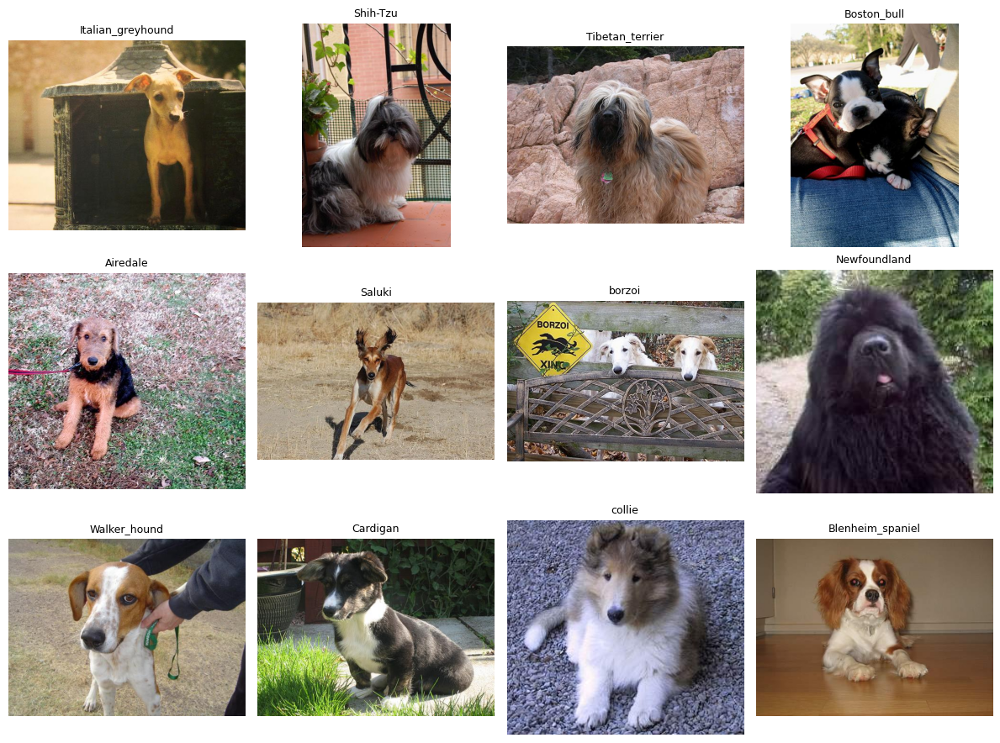

In [7]:
# Visualize some samples
def show_sample_grid(paths, labels, n=12, cols=4):
    rows = (n + cols - 1) // cols
    fig, axes = plt.subplots(rows, cols, figsize=(cols * 3, rows * 3))
    axes = axes.flatten()

    for i, (path, label) in enumerate(zip(paths[:n], labels[:n])):
        img = Image.open(path)
        axes[i].imshow(img)
        axes[i].set_title(label[:20], fontsize=9)
        axes[i].axis("off")

    for j in range(n, len(axes)):
        axes[j].axis("off")

    plt.tight_layout()
    plt.show()


show_sample_grid(image_paths, breed_labels, n=12)

## 3. Extract CLIP Embeddings


In [8]:
from transformers import CLIPProcessor, CLIPModel

# Load CLIP model
model_name = "openai/clip-vit-base-patch32"
clip_model = CLIPModel.from_pretrained(model_name).to(device)
clip_processor = CLIPProcessor.from_pretrained(model_name, use_fast=True)
clip_model.eval()

print(f"Loaded CLIP model: {model_name}")

Loaded CLIP model: openai/clip-vit-base-patch32


In [9]:
def extract_clip_embeddings(image_paths, model, processor, batch_size=32):
    """
    Extract CLIP image embeddings for a list of image paths.
    """
    embeddings = []
    model.eval()

    for i in tqdm(range(0, len(image_paths), batch_size), desc="Extracting embeddings"):
        batch_paths = image_paths[i : i + batch_size]
        batch_images = [Image.open(p).convert("RGB") for p in batch_paths]

        inputs = processor(images=batch_images, return_tensors="pt", padding=True)
        inputs = {k: v.to(device) for k, v in inputs.items()}

        with torch.inference_mode():
            image_features = model.get_image_features(**inputs)
            # L2 normalize
            image_features = image_features / image_features.norm(dim=-1, keepdim=True)

        embeddings.append(image_features.cpu())

    return torch.cat(embeddings, dim=0).numpy()


# Extract embeddings
X = extract_clip_embeddings(image_paths, clip_model, clip_processor)
print(f"Embeddings shape: {X.shape}")

# Save embeddings
image_names = [p.name for p in image_paths]
np.savez(
    OUTPUT_DIR / "stanford_dogs_embeddings.npz",
    embeddings=X,
    image_names=np.array(image_names),
    breed_labels=np.array(breed_labels),
    image_paths=np.array([str(p) for p in image_paths]),
)
print(f"Saved embeddings to {OUTPUT_DIR / 'stanford_dogs_embeddings.npz'}")

Extracting embeddings: 100%|██████████| 16/16 [00:04<00:00,  3.47it/s]

Embeddings shape: (500, 512)
Saved embeddings to ..\data\stanford_dogs\stanford_dogs_embeddings.npz


## 4. Text-Query Retrieval (Baseline)


In [11]:
def text_query_retrieval(query, embeddings, paths, labels, model, processor, k=10):
    """
    Retrieve top-k images based on text query.
    """
    # Encode query
    text_inputs = processor(text=[query], return_tensors="pt", padding=True)
    text_inputs = {k: v.to(device) for k, v in text_inputs.items()}

    with torch.inference_mode():
        text_features = model.get_text_features(**text_inputs)
        text_features = text_features / text_features.norm(dim=-1, keepdim=True)

    # Compute similarities
    text_np = text_features.cpu().numpy()
    similarities = embeddings @ text_np.T
    similarities = similarities.squeeze()

    # Get top-k
    top_k_idx = np.argsort(-similarities)[:k]

    results = []
    for idx in top_k_idx:
        results.append({"path": paths[idx], "breed": labels[idx], "score": similarities[idx]})

    return results


def visualize_results(results, query, n_show=10):
    """Visualize retrieval results."""
    n = min(n_show, len(results))
    cols = min(5, n)
    rows = (n + cols - 1) // cols

    fig, axes = plt.subplots(rows, cols, figsize=(cols * 3, rows * 3.5))
    axes = np.array(axes).reshape(-1)

    fig.suptitle(f"Query: '{query}'", fontsize=14, fontweight="bold")

    for i, res in enumerate(results[:n]):
        img = Image.open(res["path"])
        axes[i].imshow(img)
        axes[i].set_title(f"{res['breed'][:15]}\nScore: {res['score']:.3f}", fontsize=9)
        axes[i].axis("off")

    for j in range(n, len(axes)):
        axes[j].axis("off")

    plt.tight_layout()
    plt.show()

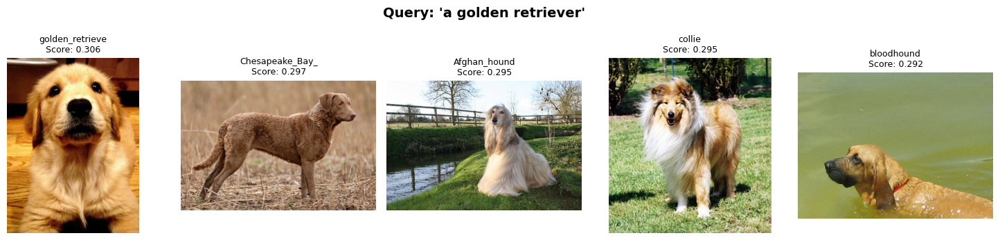

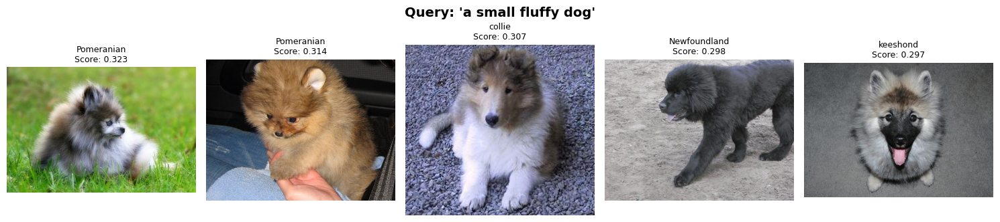

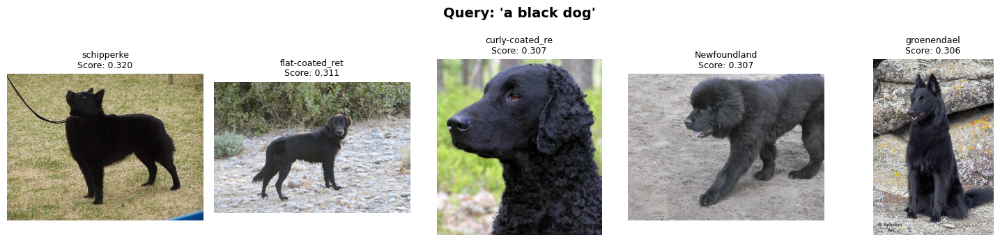

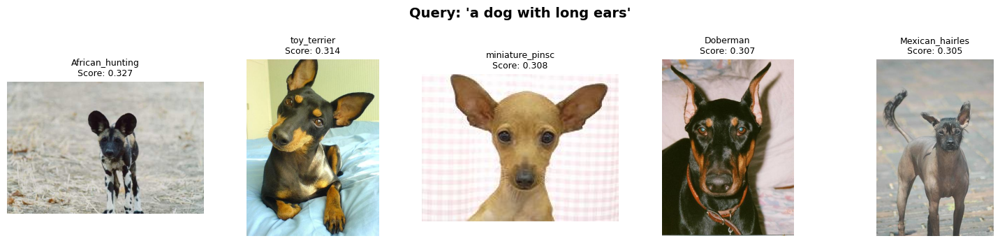

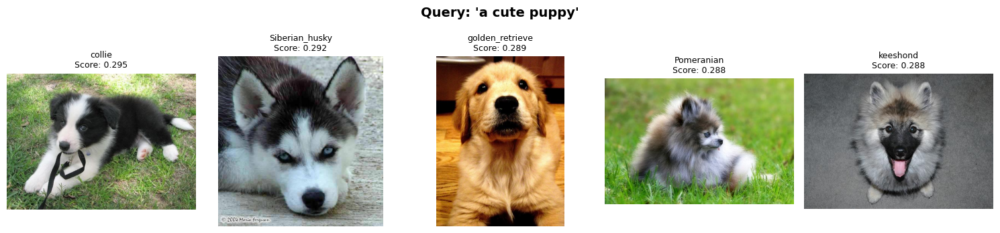

...

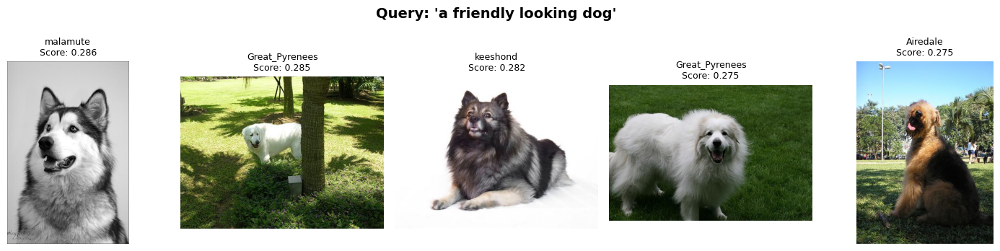

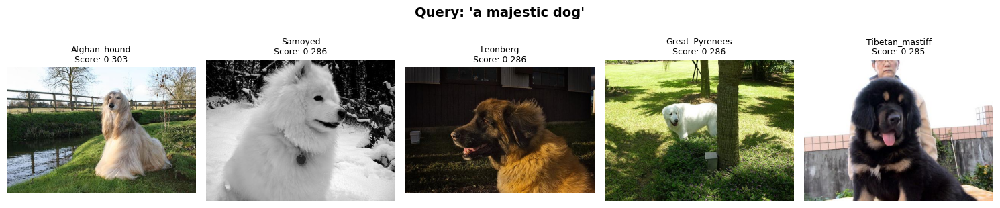

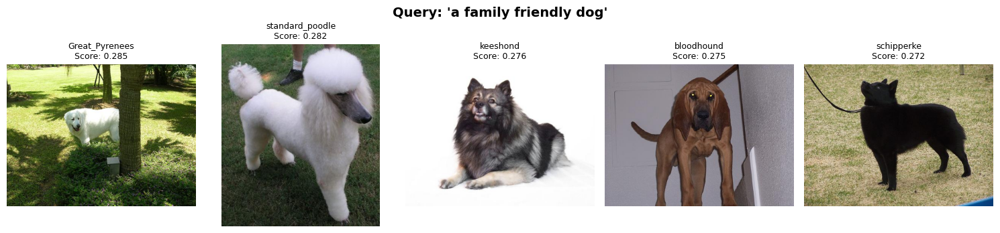

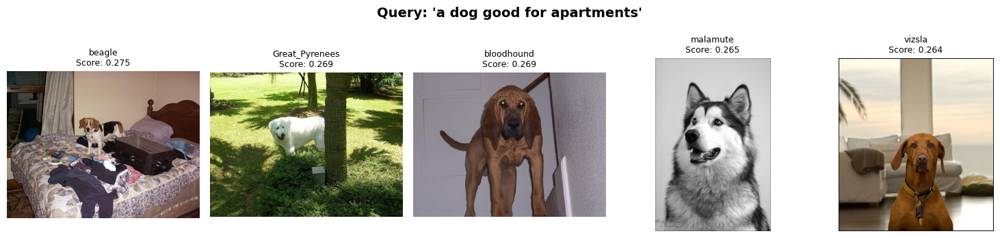

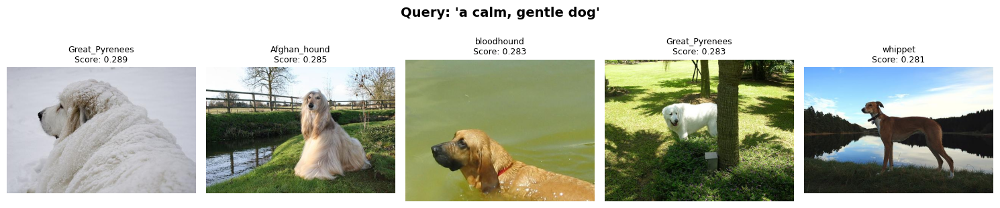

In [ ]:
# Test retrieval with various queries
queries = [
    "a golden retriever",
    "a small fluffy dog",
    "a black dog",
    "a dog with long ears",
    "a cute puppy",
    "a dog looking guilty",
    "an aggressive looking dog",
    "a friendly looking dog",
    "a majestic dog",
    "a family friendly dog",
    "a dog good for apartments",
    "a calm, gentle dog",
]

for query in queries:
    results = text_query_retrieval(query, X, image_paths, breed_labels, clip_model, clip_processor, k=10)
    visualize_results(results, query, n_show=5)

## 5. Three Types of Autoencoders

We'll implement and compare:

1. **MLP Autoencoder** - Standard reconstruction loss
2. **Variational Autoencoder (VAE)** - Reconstruction + KL divergence
3. **Sparse Autoencoder** - Reconstruction + L1 sparsity penalty


In [ ]:
# Dataset class
class EmbeddingDataset(Dataset):
    def __init__(self, X_np: np.ndarray):
        self.X = torch.from_numpy(X_np.astype(np.float32))

    def __len__(self):
        return self.X.shape[0]

    def __getitem__(self, idx):
        return self.X[idx]


# Create dataloaders
ds = EmbeddingDataset(X)
val_frac = 0.1
n_val = int(len(ds) * val_frac)
n_train = len(ds) - n_val
train_ds, val_ds = random_split(ds, [n_train, n_val], generator=torch.Generator().manual_seed(42))

batch_size = 64
train_loader = DataLoader(train_ds, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_ds, batch_size=batch_size, shuffle=False)

print(f"Train: {n_train}, Val: {n_val}")

Train: 450, Val: 50


In [ ]:
# 1. MLP Autoencoder (Standard)
class MLPAutoencoder(nn.Module):
    def __init__(self, input_dim: int, latent_dim: int = 64, hidden_dim: int = 256):
        super().__init__()
        self.encoder = nn.Sequential(
            nn.Linear(input_dim, hidden_dim),
            nn.ReLU(),
            nn.Linear(hidden_dim, latent_dim),
        )
        self.decoder = nn.Sequential(
            nn.Linear(latent_dim, hidden_dim),
            nn.ReLU(),
            nn.Linear(hidden_dim, input_dim),
        )

    def encode(self, x):
        return self.encoder(x)

    def decode(self, z):
        return self.decoder(z)

    def forward(self, x):
        z = self.encode(x)
        x_hat = self.decode(z)
        return x_hat, z


# 2. Variational Autoencoder (VAE)
class VAE(nn.Module):
    def __init__(self, input_dim: int, latent_dim: int = 64, hidden_dim: int = 256):
        super().__init__()
        self.encoder = nn.Sequential(
            nn.Linear(input_dim, hidden_dim),
            nn.ReLU(),
        )
        self.fc_mu = nn.Linear(hidden_dim, latent_dim)
        self.fc_logvar = nn.Linear(hidden_dim, latent_dim)

        self.decoder = nn.Sequential(
            nn.Linear(latent_dim, hidden_dim),
            nn.ReLU(),
            nn.Linear(hidden_dim, input_dim),
        )

    def encode(self, x):
        h = self.encoder(x)
        mu = self.fc_mu(h)
        logvar = self.fc_logvar(h)
        return mu, logvar

    def reparameterize(self, mu, logvar):
        std = torch.exp(0.5 * logvar)
        eps = torch.randn_like(std)
        return mu + eps * std

    def decode(self, z):
        return self.decoder(z)

    def forward(self, x):
        mu, logvar = self.encode(x)
        z = self.reparameterize(mu, logvar)
        x_hat = self.decode(z)
        return x_hat, z, mu, logvar


# 3. Sparse Autoencoder
class SparseAutoencoder(nn.Module):
    def __init__(self, input_dim: int, latent_dim: int = 64, hidden_dim: int = 256):
        super().__init__()
        self.encoder = nn.Sequential(
            nn.Linear(input_dim, hidden_dim),
            nn.ReLU(),
            nn.Linear(hidden_dim, latent_dim),
            nn.ReLU(),  # Non-negative activations for sparsity
        )
        self.decoder = nn.Sequential(
            nn.Linear(latent_dim, hidden_dim),
            nn.ReLU(),
            nn.Linear(hidden_dim, input_dim),
        )

    def encode(self, x):
        return self.encoder(x)

    def decode(self, z):
        return self.decoder(z)

    def forward(self, x):
        z = self.encode(x)
        x_hat = self.decode(z)
        return x_hat, z


print("Autoencoder classes defined!")

Autoencoder classes defined!


In [ ]:
def train_mlp_ae(model, train_loader, val_loader, epochs=50, lr=1e-3):
    """Train standard MLP autoencoder."""
    optimizer = torch.optim.Adam(model.parameters(), lr=lr)
    history = {"train_loss": [], "val_loss": []}

    for epoch in range(1, epochs + 1):
        # Train
        model.train()
        train_loss = 0
        for x in train_loader:
            x = x.to(device)
            optimizer.zero_grad()
            x_hat, _ = model(x)
            loss = F.mse_loss(x_hat, x)
            loss.backward()
            optimizer.step()
            train_loss += loss.item() * x.size(0)
        train_loss /= len(train_loader.dataset)

        # Validate
        model.eval()
        val_loss = 0
        with torch.no_grad():
            for x in val_loader:
                x = x.to(device)
                x_hat, _ = model(x)
                val_loss += F.mse_loss(x_hat, x).item() * x.size(0)
        val_loss /= len(val_loader.dataset)

        history["train_loss"].append(train_loss)
        history["val_loss"].append(val_loss)

        if epoch % 10 == 0:
            print(f"Epoch {epoch:3d} | Train: {train_loss:.6f} | Val: {val_loss:.6f}")

    return history


def train_vae(model, train_loader, val_loader, epochs=50, lr=1e-3, beta=0.001):
    """Train VAE with KL divergence."""
    optimizer = torch.optim.Adam(model.parameters(), lr=lr)
    history = {"train_loss": [], "val_loss": [], "train_kl": []}

    def vae_loss(x_hat, x, mu, logvar):
        recon_loss = F.mse_loss(x_hat, x, reduction="sum")
        kl_loss = -0.5 * torch.sum(1 + logvar - mu.pow(2) - logvar.exp())
        return recon_loss + beta * kl_loss, kl_loss

    for epoch in range(1, epochs + 1):
        model.train()
        train_loss, train_kl = 0, 0
        for x in train_loader:
            x = x.to(device)
            optimizer.zero_grad()
            x_hat, z, mu, logvar = model(x)
            loss, kl = vae_loss(x_hat, x, mu, logvar)
            loss.backward()
            optimizer.step()
            train_loss += loss.item()
            train_kl += kl.item()
        train_loss /= len(train_loader.dataset)
        train_kl /= len(train_loader.dataset)

        model.eval()
        val_loss = 0
        with torch.no_grad():
            for x in val_loader:
                x = x.to(device)
                x_hat, z, mu, logvar = model(x)
                loss, _ = vae_loss(x_hat, x, mu, logvar)
                val_loss += loss.item()
        val_loss /= len(val_loader.dataset)

        history["train_loss"].append(train_loss)
        history["val_loss"].append(val_loss)
        history["train_kl"].append(train_kl)

        if epoch % 10 == 0:
            print(f"Epoch {epoch:3d} | Train: {train_loss:.4f} | Val: {val_loss:.4f} | KL: {train_kl:.4f}")

    return history


def train_sparse_ae(model, train_loader, val_loader, epochs=50, lr=1e-3, sparsity_weight=0.01):
    """Train sparse autoencoder with L1 penalty."""
    optimizer = torch.optim.Adam(model.parameters(), lr=lr)
    history = {"train_loss": [], "val_loss": [], "sparsity": []}

    for epoch in range(1, epochs + 1):
        model.train()
        train_loss, sparsity_sum = 0, 0
        for x in train_loader:
            x = x.to(device)
            optimizer.zero_grad()
            x_hat, z = model(x)
            recon_loss = F.mse_loss(x_hat, x)
            l1_loss = z.abs().mean()  # L1 sparsity
            loss = recon_loss + sparsity_weight * l1_loss
            loss.backward()
            optimizer.step()
            train_loss += loss.item() * x.size(0)
            sparsity_sum += (z == 0).float().mean().item() * x.size(0)
        train_loss /= len(train_loader.dataset)
        sparsity = sparsity_sum / len(train_loader.dataset)

        model.eval()
        val_loss = 0
        with torch.no_grad():
            for x in val_loader:
                x = x.to(device)
                x_hat, z = model(x)
                val_loss += F.mse_loss(x_hat, x).item() * x.size(0)
        val_loss /= len(val_loader.dataset)

        history["train_loss"].append(train_loss)
        history["val_loss"].append(val_loss)
        history["sparsity"].append(sparsity)

        if epoch % 10 == 0:
            print(f"Epoch {epoch:3d} | Train: {train_loss:.6f} | Val: {val_loss:.6f} | Sparsity: {sparsity:.2%}")

    return history


### 5.1 Train All Three Autoencoders


In [16]:
# Configuration
input_dim = X.shape[1]  # 512
latent_dim = 64
hidden_dim = 256
epochs = 50

print("=" * 50)
print("Training MLP Autoencoder")
print("=" * 50)
mlp_ae = MLPAutoencoder(input_dim, latent_dim, hidden_dim).to(device)
mlp_history = train_mlp_ae(mlp_ae, train_loader, val_loader, epochs=epochs)

Training MLP Autoencoder
Epoch  10 | Train: 0.000568 | Val: 0.000536
Epoch  20 | Train: 0.000423 | Val: 0.000408
Epoch  30 | Train: 0.000344 | Val: 0.000342
Epoch  40 | Train: 0.000290 | Val: 0.000306
Epoch  50 | Train: 0.000255 | Val: 0.000282


In [17]:
print("=" * 50)
print("Training Variational Autoencoder (VAE)")
print("=" * 50)
vae = VAE(input_dim, latent_dim, hidden_dim).to(device)
vae_history = train_vae(vae, train_loader, val_loader, epochs=epochs, beta=0.001)

Training Variational Autoencoder (VAE)
Epoch  10 | Train: 0.5236 | Val: 0.4749 | KL: 75.4740
Epoch  20 | Train: 0.4132 | Val: 0.3918 | KL: 72.8287
Epoch  30 | Train: 0.3957 | Val: 0.3762 | KL: 65.3862
Epoch  40 | Train: 0.3842 | Val: 0.3669 | KL: 59.3415
Epoch  50 | Train: 0.3740 | Val: 0.3580 | KL: 53.5265


In [18]:
print("=" * 50)
print("Training Sparse Autoencoder")
print("=" * 50)
sparse_ae = SparseAutoencoder(input_dim, latent_dim, hidden_dim).to(device)
sparse_history = train_sparse_ae(sparse_ae, train_loader, val_loader, epochs=epochs, sparsity_weight=0.01)

Training Sparse Autoencoder
Epoch  10 | Train: 0.000624 | Val: 0.000578 | Sparsity: 100.00%
Epoch  20 | Train: 0.000623 | Val: 0.000577 | Sparsity: 100.00%
Epoch  30 | Train: 0.000622 | Val: 0.000584 | Sparsity: 100.00%
Epoch  40 | Train: 0.000619 | Val: 0.000578 | Sparsity: 100.00%
Epoch  50 | Train: 0.000620 | Val: 0.000577 | Sparsity: 100.00%


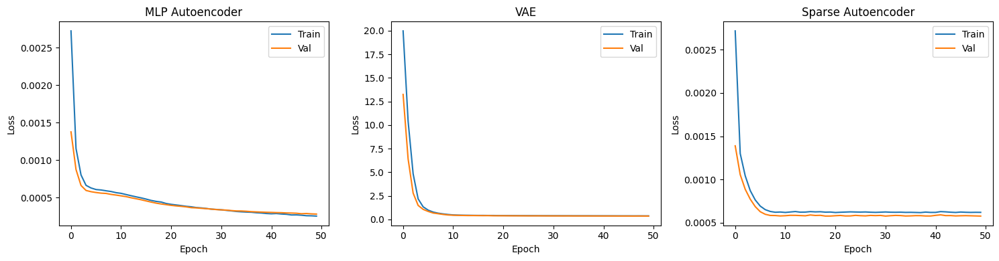

In [29]:
# Plot training curves
fig, axes = plt.subplots(1, 3, figsize=(15, 4))

# MLP AE
axes[0].plot(mlp_history["train_loss"], label="Train")
axes[0].plot(mlp_history["val_loss"], label="Val")
axes[0].set_title("MLP Autoencoder")
axes[0].set_xlabel("Epoch")
axes[0].set_ylabel("Loss")
axes[0].legend()

# VAE
axes[1].plot(vae_history["train_loss"], label="Train")
axes[1].plot(vae_history["val_loss"], label="Val")
axes[1].set_title("VAE")
axes[1].set_xlabel("Epoch")
axes[1].set_ylabel("Loss")
axes[1].legend()

# Sparse AE
axes[2].plot(sparse_history["train_loss"], label="Train")
axes[2].plot(sparse_history["val_loss"], label="Val")
axes[2].set_title("Sparse Autoencoder")
axes[2].set_xlabel("Epoch")
axes[2].set_ylabel("Loss")
axes[2].legend()

plt.tight_layout()
plt.show()

## 6. Compare Reconstruction Quality


In [30]:
@torch.no_grad()
def evaluate_reconstruction(model, X_np, model_type="mlp"):
    """
    Evaluate reconstruction quality.
    Returns MSE and cosine similarity metrics.
    """
    model.eval()
    x = torch.from_numpy(X_np.astype(np.float32)).to(device)

    if model_type == "vae":
        x_hat, z, mu, logvar = model(x)
        z = mu  # Use mean for evaluation
    else:
        x_hat, z = model(x)

    mse = F.mse_loss(x_hat, x).item()
    cos_sim = F.cosine_similarity(x_hat, x, dim=1).mean().item()

    return {"mse": mse, "cosine_similarity": cos_sim, "latents": z.cpu().numpy(), "reconstructions": x_hat.cpu().numpy()}


# Evaluate all models
print("Evaluating reconstruction quality...\n")

mlp_metrics = evaluate_reconstruction(mlp_ae, X, "mlp")
vae_metrics = evaluate_reconstruction(vae, X, "vae")
sparse_metrics = evaluate_reconstruction(sparse_ae, X, "sparse")

print(f"{'Model':<20} {'MSE':<12} {'Cosine Sim':<12}")
print("-" * 44)
print(f"{'MLP Autoencoder':<20} {mlp_metrics['mse']:<12.6f} {mlp_metrics['cosine_similarity']:<12.4f}")
print(f"{'VAE':<20} {vae_metrics['mse']:<12.6f} {vae_metrics['cosine_similarity']:<12.4f}")
print(f"{'Sparse AE':<20} {sparse_metrics['mse']:<12.6f} {sparse_metrics['cosine_similarity']:<12.4f}")

Evaluating reconstruction quality...

Model                MSE          Cosine Sim  
--------------------------------------------
MLP Autoencoder      0.000250     0.9334      
VAE                  0.000619     0.8270      
Sparse AE            0.000611     0.8291      


In [31]:
# Compare latent space statistics
print("\nLatent Space Statistics:")
print("=" * 60)

for name, metrics in [("MLP AE", mlp_metrics), ("VAE", vae_metrics), ("Sparse AE", sparse_metrics)]:
    Z = metrics["latents"]
    sparsity = (np.abs(Z) < 0.01).mean()  # Near-zero activations
    variance = Z.var(axis=0).mean()
    print(f"\n{name}:")
    print(f"  Shape: {Z.shape}")
    print(f"  Mean: {Z.mean():.4f}")
    print(f"  Std: {Z.std():.4f}")
    print(f"  Sparsity (|z| < 0.01): {sparsity:.2%}")
    print(f"  Mean variance per dim: {variance:.4f}")


Latent Space Statistics:

MLP AE:
  Shape: (500, 64)
  Mean: -0.0195
  Std: 0.1134
  Sparsity (|z| < 0.01): 8.15%
  Mean variance per dim: 0.0030

VAE:
  Shape: (500, 64)
  Mean: -0.0052
  Std: 0.6142
  Sparsity (|z| < 0.01): 0.78%
  Mean variance per dim: 0.0018

Sparse AE:
  Shape: (500, 64)
  Mean: 0.0000
  Std: 0.0000
  Sparsity (|z| < 0.01): 100.00%
  Mean variance per dim: 0.0000


## 7. Visualize Latent Unit Extremes

For each autoencoder, we'll visualize what different latent dimensions capture by showing images with the highest and lowest values along each dimension.


In [39]:
def show_image_grid(image_paths_list, title=None, scores=None, cols=6, figsize_scale=3.2):
    """
    Lightweight image grid with optional score captions.
    Matches the style from step-02-AEs_extremes.ipynb.
    """
    n = len(image_paths_list)
    rows = (n + cols - 1) // cols
    fig, axes = plt.subplots(rows, cols, figsize=(cols * figsize_scale, rows * figsize_scale))
    axes = np.array(axes).reshape(-1)

    if title:
        fig.suptitle(title, fontsize=14)

    for i, img_path in enumerate(image_paths_list):
        ax = axes[i]
        if Path(img_path).exists():
            ax.imshow(Image.open(img_path))
        else:
            ax.text(0.5, 0.5, f"Missing", ha="center", va="center")
        ax.axis("off")
        if scores is not None:
            ax.set_title(f"{scores[i]:.3f}", fontsize=9)

    for j in range(n, len(axes)):
        axes[j].axis("off")

    plt.tight_layout()
    plt.show()


def latent_extremes_indices(Z, dim_idx, k=12):
    """
    Returns indices of the k lowest and k highest examples along latent dimension dim_idx.
    """
    if dim_idx < 0 or dim_idx >= Z.shape[1]:
        raise ValueError(f"dim_idx={dim_idx} out of bounds for Z with shape {Z.shape}")
    order = np.argsort(Z[:, dim_idx])
    low = order[:k]
    high = order[-k:][::-1]
    return low, high


def visualize_latent_unit_extremes(Z, dim_idx, image_paths, k=12, title_prefix=""):
    """
    Shows two grids: LOW and HIGH extremes for a latent unit.
    Matches the visualization style from step-02-AEs_extremes.ipynb.
    """
    low_idx, high_idx = latent_extremes_indices(Z, dim_idx=dim_idx, k=k)
    low_imgs = [image_paths[i] for i in low_idx]
    high_imgs = [image_paths[i] for i in high_idx]

    # Captions: actual latent values for those images
    low_scores = Z[low_idx, dim_idx]
    high_scores = Z[high_idx, dim_idx]

    show_image_grid(low_imgs, title=f"{title_prefix}Latent dim {dim_idx} — LOW (k={k})", scores=low_scores, cols=6)
    show_image_grid(high_imgs, title=f"{title_prefix}Latent dim {dim_idx} — HIGH (k={k})", scores=high_scores, cols=6)


def scan_latent_units(Z, image_paths, k=8, top_units=6, title_prefix=""):
    """
    Quick helper: find latent dimensions with highest variance and visualize them.
    Good for picking 'interesting' units.
    """
    variances = np.var(Z, axis=0)
    dims = np.argsort(-variances)[:top_units]
    print(f"Top dims by variance: {dims.tolist()}")
    print(f"Variances: {[f'{variances[d]:.4f}' for d in dims]}")
    for d in dims:
        visualize_latent_unit_extremes(Z, d, image_paths, k=k, title_prefix=title_prefix)

MLP Autoencoder - Latent Unit Extremes
Top dims by variance: [45, 32, 8, 58]
Variances: ['0.0049', '0.0044', '0.0044', '0.0043']


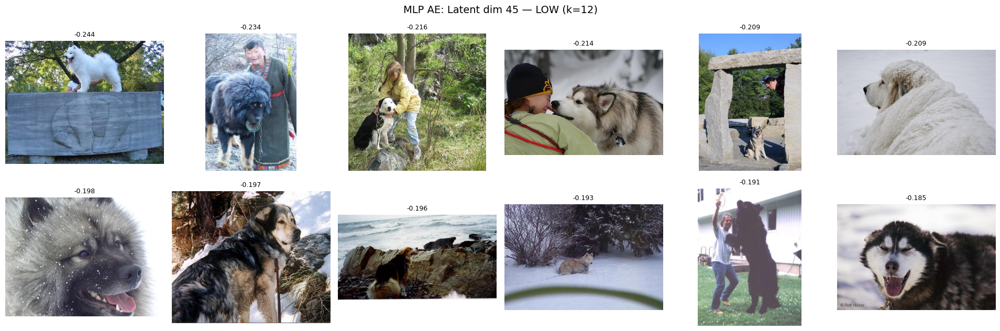

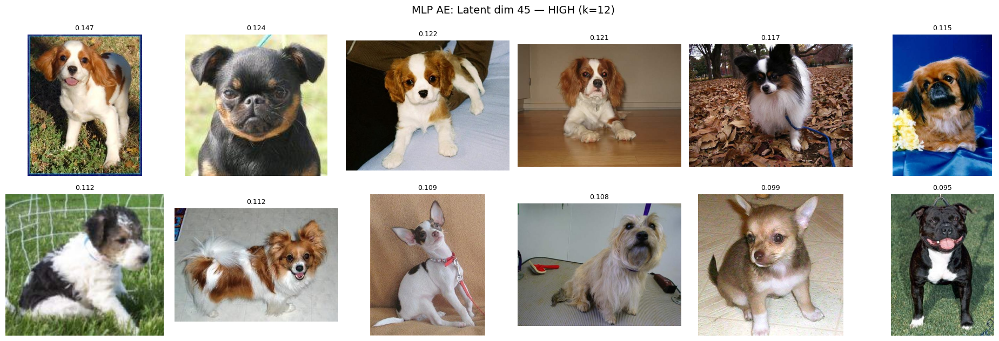

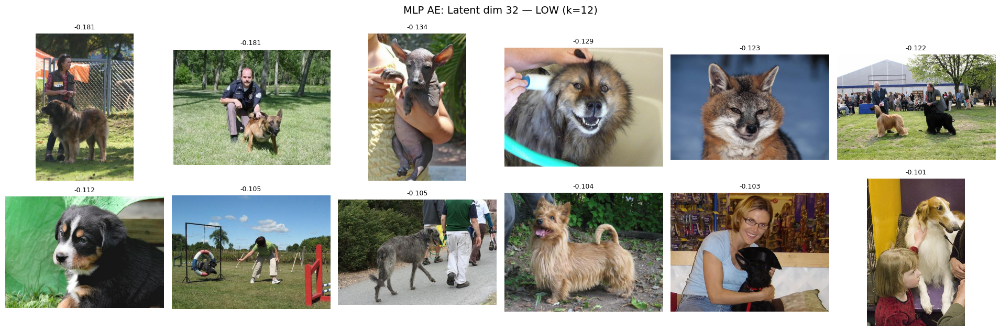

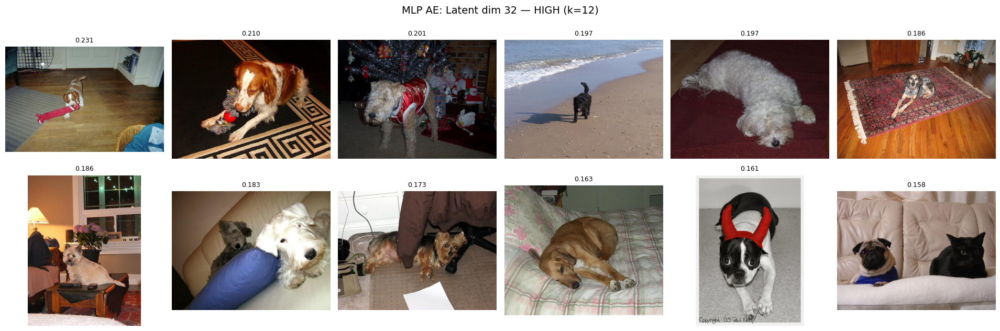

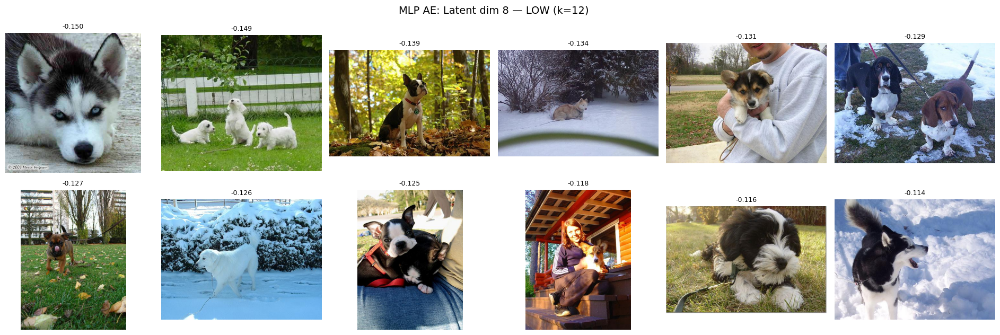

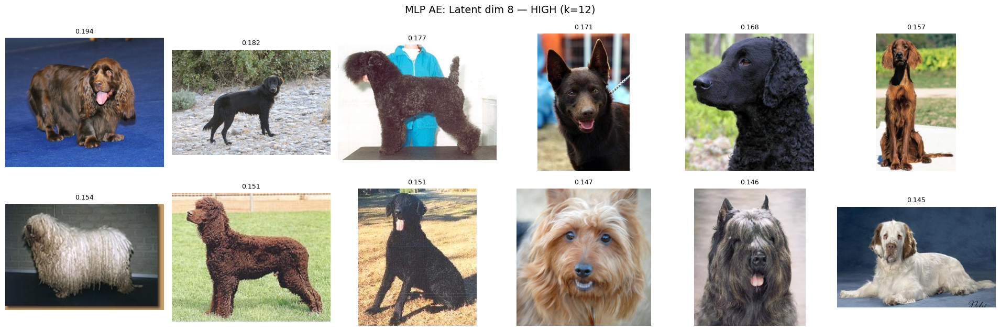

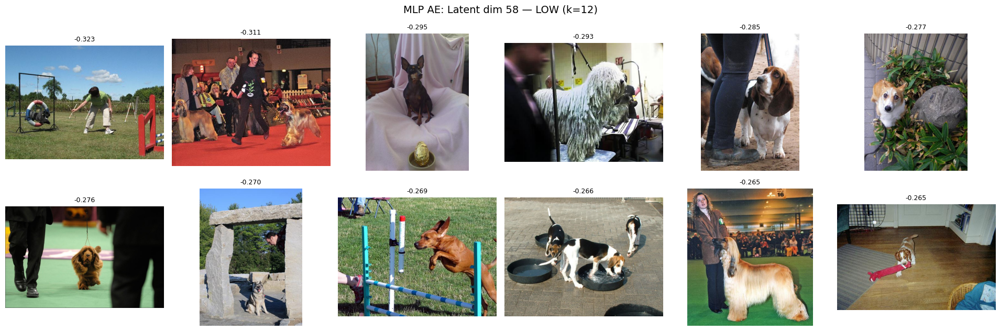

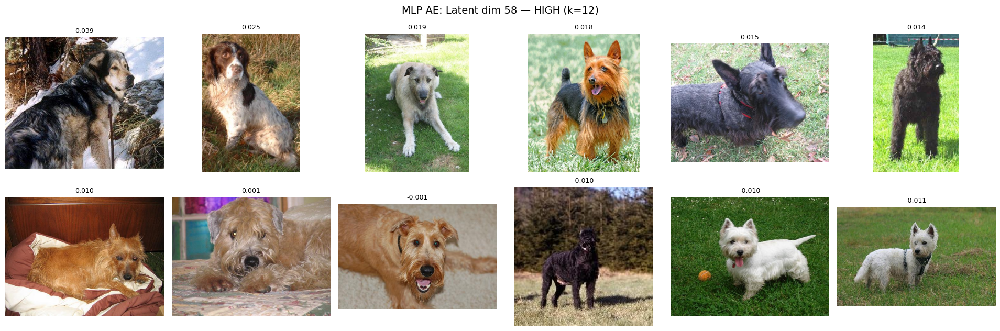

In [40]:
# MLP Autoencoder latent extremes
print("=" * 60)
print("MLP Autoencoder - Latent Unit Extremes")
print("=" * 60)

scan_latent_units(mlp_metrics["latents"], image_paths, k=12, top_units=4, title_prefix="MLP AE: ")

VAE - Latent Unit Extremes
Top dims by variance: [53, 11, 63, 29]
Variances: ['0.0068', '0.0064', '0.0054', '0.0049']


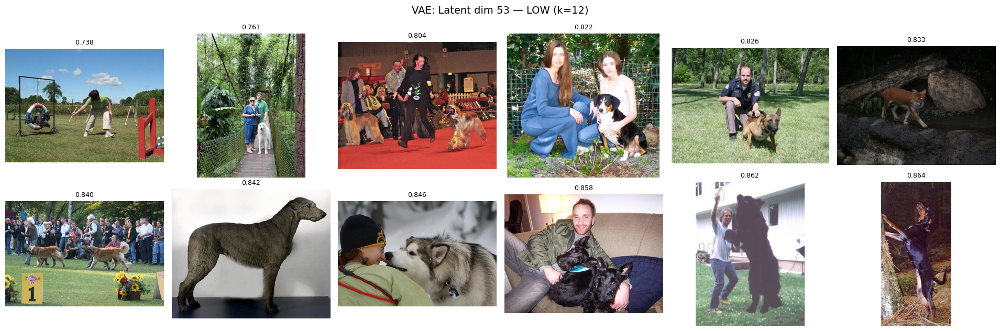

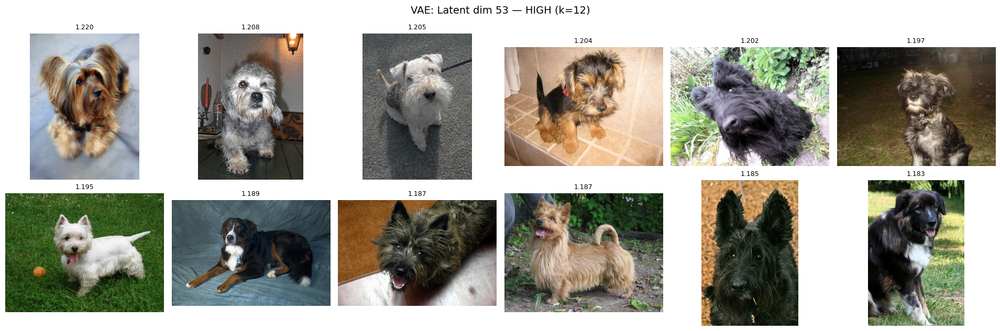

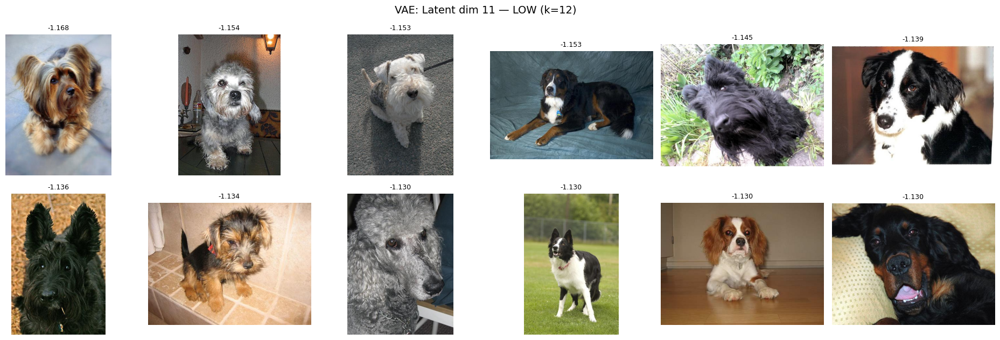

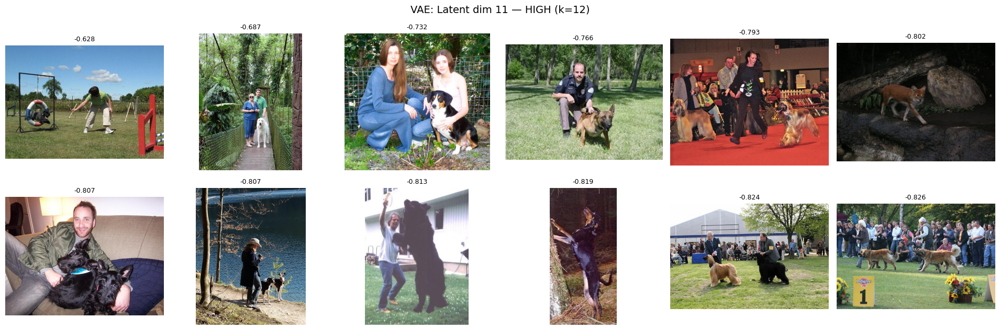

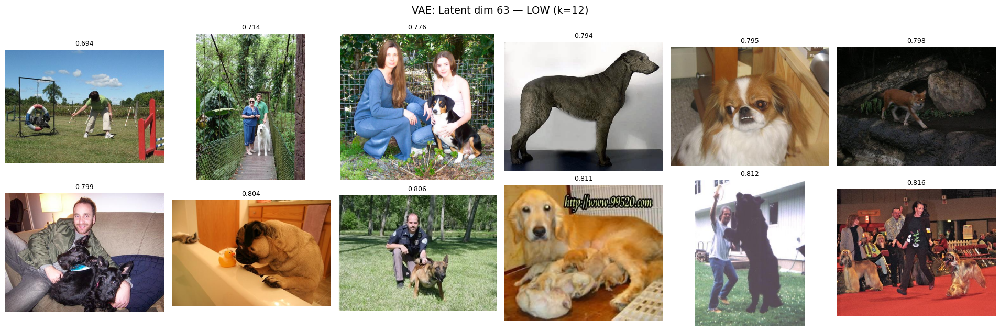

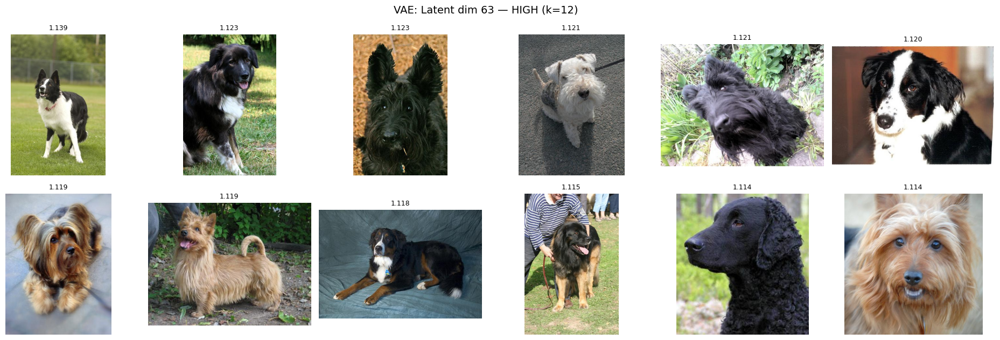

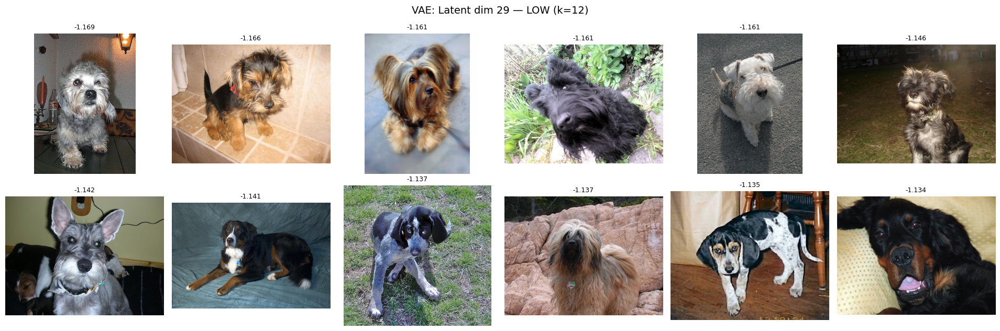

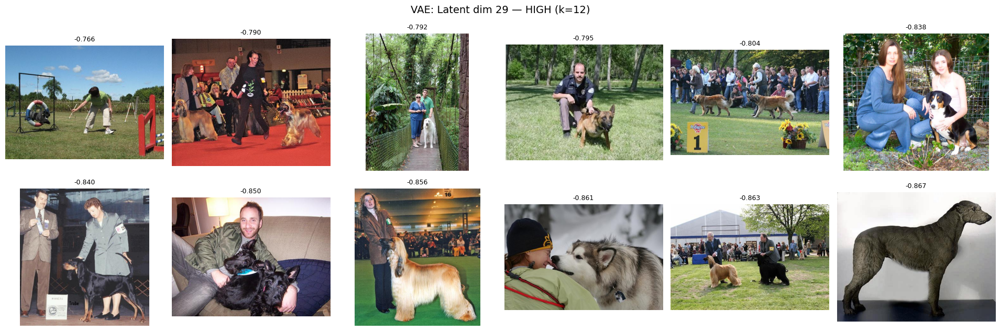

In [41]:
# VAE latent extremes
print("=" * 60)
print("VAE - Latent Unit Extremes")
print("=" * 60)

scan_latent_units(vae_metrics["latents"], image_paths, k=12, top_units=4, title_prefix="VAE: ")

In [42]:
# Sparse Autoencoder latent extremes
print("=" * 60)
print("Sparse Autoencoder - Latent Unit Extremes")
print("=" * 60)

# Note: Sparse AE may have all-zero latents if sparsity is too strong
if sparse_metrics["latents"].var() > 1e-8:
    scan_latent_units(sparse_metrics["latents"], image_paths, k=12, top_units=4, title_prefix="Sparse AE: ")
else:
    print("Sparse AE latents are all zero (sparsity too strong). Skipping visualization.")
    print("Try reducing sparsity_weight or increasing training epochs.")

Sparse Autoencoder - Latent Unit Extremes
Sparse AE latents are all zero (sparsity too strong). Skipping visualization.
Try reducing sparsity_weight or increasing training epochs.


## 8. Save Models and Results


In [43]:
# Save models
torch.save(
    {"state_dict": mlp_ae.state_dict(), "input_dim": input_dim, "latent_dim": latent_dim, "hidden_dim": hidden_dim, "type": "mlp"}, MODELS_DIR / "mlp_ae.pt"
)
print(f"Saved MLP AE to {MODELS_DIR / 'mlp_ae.pt'}")

torch.save({"state_dict": vae.state_dict(), "input_dim": input_dim, "latent_dim": latent_dim, "hidden_dim": hidden_dim, "type": "vae"}, MODELS_DIR / "vae.pt")
print(f"Saved VAE to {MODELS_DIR / 'vae.pt'}")

torch.save(
    {"state_dict": sparse_ae.state_dict(), "input_dim": input_dim, "latent_dim": latent_dim, "hidden_dim": hidden_dim, "type": "sparse"},
    MODELS_DIR / "sparse_ae.pt",
)
print(f"Saved Sparse AE to {MODELS_DIR / 'sparse_ae.pt'}")

Saved MLP AE to ..\models\stanford_dogs\mlp_ae.pt
Saved VAE to ..\models\stanford_dogs\vae.pt
Saved Sparse AE to ..\models\stanford_dogs\sparse_ae.pt


In [44]:
# Save latent representations
np.savez(
    OUTPUT_DIR / "latent_representations.npz",
    mlp_latents=mlp_metrics["latents"],
    vae_latents=vae_metrics["latents"],
    sparse_latents=sparse_metrics["latents"],
    image_names=np.array(image_names),
    breed_labels=np.array(breed_labels),
    image_paths=np.array([str(p) for p in image_paths]),
)
print(f"Saved latent representations to {OUTPUT_DIR / 'latent_representations.npz'}")

Saved latent representations to ..\data\stanford_dogs\latent_representations.npz


Compared 3 different autoencoder architectures on Stanford Dogs CLIP embeddings:

| Model         | Key Feature                  | Pros                            | Cons                       |
| ------------- | ---------------------------- | ------------------------------- | -------------------------- |
| **MLP AE**    | Standard reconstruction      | Simple, good reconstruction     | May overfit, dense latents |
| **VAE**       | KL divergence regularization | Smooth latent space, generative | Blurry reconstructions     |
| **Sparse AE** | L1 sparsity penalty          | Interpretable features, sparse  | May lose information       |

The latent extremes visualizations show what each dimension has learned to encode.
